In [1]:
import pandas as pd
import numpy as np
from statsmodels.tsa.stattools import adfuller
import plotly.express as px
import plotly.graph_objects as go
from statsmodels.tsa.stattools import pacf, acf
from datetime import datetime

In [130]:
def create_corr_plot(series, plot_pacf=False):
    corr_array = pacf(series.dropna(), alpha=0.05) if plot_pacf else acf(series.dropna(), alpha=0.05)
    lower_y = corr_array[1][:,0] - corr_array[0]
    upper_y = corr_array[1][:,1] - corr_array[0]

    fig = go.Figure()
    [fig.add_scatter(x=(x,x), y=(0,corr_array[0][x]), mode='lines',line_color='#3f3f3f') 
     for x in range(len(corr_array[0]))]
    fig.add_scatter(x=np.arange(len(corr_array[0])), y=corr_array[0], mode='markers', marker_color='#1f77b4',
                   marker_size=12)
    fig.add_scatter(x=np.arange(len(corr_array[0])), y=upper_y, mode='lines', line_color='rgba(255,255,255,0)')
    fig.add_scatter(x=np.arange(len(corr_array[0])), y=lower_y, mode='lines',fillcolor='rgba(32, 146, 230,0.3)',
            fill='tonexty', line_color='rgba(255,255,255,0)')
    fig.update_traces(showlegend=False)
    fig.update_xaxes(range=[-1,42])
    fig.update_yaxes(zerolinecolor='#000000')
    
    title='Partial Autocorrelation (PACF)' if plot_pacf else 'Autocorrelation (ACF)'
    fig.update_layout(title=title)
    fig.show()

In [2]:
df_gmc = pd.read_csv('../data/gmc/sigesguarda_cleaned.csv')
df_gmc['OCORRENCIA_DATA_SEM_HORARIO'] = pd.to_datetime(df_gmc['OCORRENCIA_DATA'], format='%Y-%m-%d %H:%M:%S.%f').dt.date

df_gmc.sample(5)

/home/radek/TCC/venv/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3397: DtypeWarning: Columns (15,19,20,33) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


,ATENDIMENTO_ANO,ATENDIMENTO_BAIRRO_NOME,EQUIPAMENTO_URBANO_NOME,FLAG_EQUIPAMENTO_URBANO,FLAG_FLAGRANTE,LOGRADOURO_NOME,NATUREZA1_DEFESA_CIVIL,NATUREZA1_DESCRICAO,NATUREZA2_DEFESA_CIVIL,NATUREZA2_DESCRICAO,...,OPERACAO_DESCRICAO,ORIGEM_CHAMADO_DESCRICAO,REGIONAL_FATO_NOME,SECRETARIA_NOME,SECRETARIA_SIGLA,SERVICO_NOME,SITUACAO_EQUIPE_DESCRICAO,NUMERO_PROTOCOLO_156,OCORRENCIA_DATA_SEM_HORARIO,FERIADO
306443,2020,SITIO CERCADO,NaN,NÃO,NÃO,MOYSES GUTZTEIN,0,Trânsito,NaN,NaN,...,NORMAL,156,BAIRRO NOVO,SECRETARIA MUNICIPAL DE DEFESA SOCIAL E TRANSITO,SMDT,NORMAL,Solicitação,NaN,2020-09-10,0
51102,2011,SANTA CANDIDA,NaN,NÃO,NÃO,FERNANDO DE NORONHA,0,Atitude Suspeita (Abordagem),NaN,NaN,...,NaN,IMEDIATA,BOA VISTA,SECRETARIA MUNICIPAL DE DEFESA SOCIAL E TRANSITO,SMDT,NORMAL,NaN,NaN,2011-02-18,0
95157,2013,CAMPO DE SANTANA,NaN,NÃO,NÃO,ELIZEU VALENTIN DE LIMA,0,Dano,NaN,NaN,...,NaN,153,PINHEIRINHO,SECRETARIA MUNICIPAL MEIO AMBIENTE,SMMA,NORMAL,NaN,NaN,2013-04-14,0
223297,2018,SITIO CERCADO,NaN,NÃO,NÃO,MÚSICO ANTERO GONÇALVES DA SILVA,1,Depósito irregular,NaN,NaN,...,NORMAL,153,BAIRRO NOVO,SECRETARIA MUNICIPAL DE DEFESA SOCIAL E TRANSITO,SMDT,NORMAL,Solicitação,NaN,2018-09-08,0
202827,2017,SANTO INACIO,PARQUE BARIGUI,SIM,NÃO,BR-277 - CURITIBA / PONTA GROSSA,0,Atitude Suspeita,NaN,NaN,...,NORMAL,153,SANTA FELICIDADE,SECRETARIA MUNICIPAL DE DEFESA SOCIAL E TRANSITO,SMDT,NORMAL,Solicitação,NaN,2017-10-15,0


In [3]:
df_series = df_gmc[['ATENDIMENTO_ANO','ATENDIMENTO_BAIRRO_NOME','OCORRENCIA_ANO','OCORRENCIA_DATA','OCORRENCIA_DIA_SEMANA','OCORRENCIA_MES','NATUREZA1_DESCRICAO']].copy()

df_series['OCORRENCIA_DATA'] = pd.to_datetime(df_series['OCORRENCIA_DATA'], format='%Y-%m-%d %H:%M:%S.%f')
df_series['OCORRENCIA_DIA'] = df_series['OCORRENCIA_DATA'].apply(lambda x: x.day)
df_series['OCORRENCIA_HORA'] = df_series['OCORRENCIA_DATA'].apply(lambda x: x.hour)
df_series['OCORRENCIA_MINUTO'] = df_series['OCORRENCIA_DATA'].apply(lambda x: x.minute)

df_series = df_series[['ATENDIMENTO_ANO','OCORRENCIA_DIA','OCORRENCIA_MES','OCORRENCIA_ANO','OCORRENCIA_DIA_SEMANA','OCORRENCIA_HORA','OCORRENCIA_MINUTO','ATENDIMENTO_BAIRRO_NOME','NATUREZA1_DESCRICAO']]
df_series.tail()

In [4]:
df_alltime = df_gmc.groupby(['OCORRENCIA_DATA_SEM_HORARIO']).size().reset_index(name='OCORRENCIAS_ATENDIDAS')
df_alltime.head()

In [168]:
px.line(df_alltime,x='OCORRENCIA_DATA_SEM_HORARIO',y='OCORRENCIAS_ATENDIDAS')

# ARIMA Model

In [101]:
def adfuller_test(series,diff=False):
    if diff:
        series = series.diff()[1:]
    result = adfuller(np.array(series))
    print('ADF Statistic: {}'.format(result[0]))
    print('p-value: {}'.format(result[1]))

adfuller_test(df_alltime['OCORRENCIAS_ATENDIDAS'].squeeze(), True)

In [147]:
create_corr_plot(df_alltime['OCORRENCIAS_ATENDIDAS'].squeeze(), plot_pacf=True)

In [148]:
create_corr_plot(df_alltime['OCORRENCIAS_ATENDIDAS'].squeeze())

In [5]:
from statsmodels.tsa.arima.model import ARIMA

In [6]:

series = np.array(df_alltime['OCORRENCIAS_ATENDIDAS'].squeeze())
arima_model = ARIMA(series, order=(2,2,7))
model = arima_model.fit()
print(model.summary())

In [7]:
df_result = pd.DataFrame([series,model.predict(start=0,end=10000)]).transpose().reset_index().rename(columns={0:'Real',1:'Predito'})
px.line(df_result,x='index',y=df_result.columns)

## Regression Model

In [3]:
from statsmodels.regression.linear_model import OLS
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
import statsmodels.formula.api as smf
import math

In [4]:
def evaluate_ols(results, X, y):
    print(f'params:\n{results.params}\n')
    print(f'rsquared:\n{results.rsquared}\n')
    print(f'rsquared_adj:\n{results.rsquared_adj}\n')
    print(f'mse:\n{mean_squared_error(y, results.predict(X))}\n')
    print(f'rmse:\n{math.sqrt(mean_squared_error(y, results.predict(X)))}\n')
    print(f'mae:\n{mean_absolute_error(y, results.predict(X))}')

In [5]:
df_gmc_ols_model = df_gmc
df_gmc_ols_model = df_gmc_ols_model.groupby(['OCORRENCIA_DATA_SEM_HORARIO','FERIADO']).size().reset_index(name='OCORRENCIAS_ATENDIDAS')
df_gmc_ols_model['x0_final_de_semana'] = df_gmc_ols_model['OCORRENCIA_DATA_SEM_HORARIO'].apply(lambda x: 1 if x.weekday() == 5 or x.weekday() == 6 else 0)
df_gmc_ols_model['x1_time'] = np.arange(df_gmc_ols_model.shape[0])
df_gmc_ols_model['x2_lag1'] = df_gmc_ols_model['OCORRENCIAS_ATENDIDAS'].shift(1).fillna(0)
df_gmc_ols_model['x3_lag2'] = df_gmc_ols_model['OCORRENCIAS_ATENDIDAS'].shift(2).fillna(0)
df_gmc_ols_model['x4_lag3'] = df_gmc_ols_model['OCORRENCIAS_ATENDIDAS'].shift(3).fillna(0)
df_gmc_ols_model['x5_lag4'] = df_gmc_ols_model['OCORRENCIAS_ATENDIDAS'].shift(4).fillna(0)
df_gmc_ols_model['x6_lag5'] = df_gmc_ols_model['OCORRENCIAS_ATENDIDAS'].shift(5).fillna(0)
df_gmc_ols_model['x7_lag6'] = df_gmc_ols_model['OCORRENCIAS_ATENDIDAS'].shift(6).fillna(0)
df_gmc_ols_model['x8_lag7'] = df_gmc_ols_model['OCORRENCIAS_ATENDIDAS'].shift(7).fillna(0)
df_gmc_ols_model['x9_window_mean'] = df_gmc_ols_model['OCORRENCIAS_ATENDIDAS'].shift(1).rolling(window=7).mean().fillna(0)
df_gmc_ols_model['x10_feriado'] = df_gmc_ols_model['FERIADO']
df_gmc_ols_model['x11_pandemia'] = df_gmc_ols_model['OCORRENCIA_DATA_SEM_HORARIO'].apply(lambda x: 1 if x >= datetime.strptime('11/03/2020','%d/%m/%Y').date() else 0)
df_gmc_ols_model['x12_dia_semana'] = df_gmc_ols_model['OCORRENCIA_DATA_SEM_HORARIO'].apply(lambda x: x.weekday())
df_gmc_ols_model

,OCORRENCIA_DATA_SEM_HORARIO,FERIADO,OCORRENCIAS_ATENDIDAS,x0_final_de_semana,x1_time,x2_lag1,x3_lag2,x4_lag3,x5_lag4,x6_lag5,x7_lag6,x8_lag7,x9_window_mean,x10_feriado,x11_pandemia,x12_dia_semana
0,2009-01-01,1,30,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1,0,3
1,2009-01-02,0,81,0,1,30.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0,0,4
2,2009-01-03,0,96,1,2,81.0,30.0,0.0,0.0,0.0,0.0,0.0,0.000000,0,0,5
3,2009-01-04,0,93,1,3,96.0,81.0,30.0,0.0,0.0,0.0,0.0,0.000000,0,0,6
4,2009-01-05,0,59,0,4,93.0,96.0,81.0,30.0,0.0,0.0,0.0,0.000000,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4802,2022-02-24,0,166,0,4802,150.0,173.0,150.0,135.0,166.0,143.0,183.0,157.142857,0,1,3
4803,2022-02-25,0,143,0,4803,166.0,150.0,173.0,150.0,135.0,166.0,143.0,154.714286,0,1,4
4804,2022-02-26,0,142,1,4804,143.0,166.0,150.0,173.0,150.0,135.0,166.0,154.714286,0,1,5
4805,2022-02-27,0,143,1,4805,142.0,143.0,166.0,150.0,173.0,150.0,135.0,151.285714,0,1,6


### Model 1

In [12]:
X_model1, y_model1 = df_gmc_ols_model[['x1_time']], df_gmc_ols_model['OCORRENCIAS_ATENDIDAS']

model1 = OLS(y_model1, X_model1)
results1 = model1.fit()

results1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  OLS Regression Results                                  
==========================================================================================
Dep. Variable:     OCORRENCIAS_ATENDIDAS   R-squared (uncentered):                   0.804
Model:                               OLS   Adj. R-squared (uncentered):              0.804
Method:                    Least Squares   F-statistic:                          1.966e+04
Date:                   Fri, 14 Oct 2022   Prob (F-statistic):                        0.00
Time:                           12:35:08   Log-Likelihood:                         -24660.
No. Observations:                   4807   AIC:                                  4.932e+04
Df Residuals:                       4806   BIC:                                  4.933e+04
Df Model:                              1                                                  
Covariance Type:               nonrobust                                                  
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
x1_time        0.0298      0.000    140.205      0.000       0.029       0.030
==============================================================================
Omnibus:                     1708.335   Durbin-Watson:                   0.385
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            15118.775
Skew:                           1.443   Prob(JB):                         0.00
Kurtosis:                      11.194   Cond. No.                         1.00
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [23]:
df_results1 = pd.DataFrame([y_model1, results1.predict(X_model1)]).transpose().reset_index()
px.line(df_results1,x='index',y=df_results1.columns)

### Model 2

In [13]:
X_model2, y_model2 = df_gmc_ols_model[['x1_time','x0_final_de_semana']], df_gmc_ols_model['OCORRENCIAS_ATENDIDAS']

model2 = OLS(y_model2, X_model2)
results2 = model2.fit()

results2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  OLS Regression Results                                  
==========================================================================================
Dep. Variable:     OCORRENCIAS_ATENDIDAS   R-squared (uncentered):                   0.818
Model:                               OLS   Adj. R-squared (uncentered):              0.818
Method:                    Least Squares   F-statistic:                          1.081e+04
Date:                   Fri, 14 Oct 2022   Prob (F-statistic):                        0.00
Time:                           12:35:38   Log-Likelihood:                         -24473.
No. Observations:                   4807   AIC:                                  4.895e+04
Df Residuals:                       4805   BIC:                                  4.896e+04
Df Model:                              2                                                  
Covariance Type:               nonrobust                                                  
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
x1_time                0.0277      0.000    120.050      0.000       0.027       0.028
x0_final_de_semana    23.5776      1.198     19.686      0.000      21.230      25.926
==============================================================================
Omnibus:                     1710.486   Durbin-Watson:                   0.410
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            18721.552
Skew:                           1.379   Prob(JB):                         0.00
Kurtosis:                      12.266   Cond. No.                     5.86e+03
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 5.86e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [26]:
df_results2 = pd.DataFrame([y_model2,results2.predict(X_model2)]).transpose().reset_index()
px.line(df_results2,x='index',y=df_results2.columns)

### Model 3

In [7]:
X_model3, y_model3 = df_gmc_ols_model[['x0_final_de_semana','x1_time','x10_feriado']], df_gmc_ols_model['OCORRENCIAS_ATENDIDAS']

model3 = OLS(y_model3, X_model3)
results3 = model3.fit()

results3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  OLS Regression Results                                  
==========================================================================================
Dep. Variable:     OCORRENCIAS_ATENDIDAS   R-squared (uncentered):                   0.818
Model:                               OLS   Adj. R-squared (uncentered):              0.818
Method:                    Least Squares   F-statistic:                              7214.
Date:                   Fri, 14 Oct 2022   Prob (F-statistic):                        0.00
Time:                           12:44:56   Log-Likelihood:                         -24471.
No. Observations:                   4807   AIC:                                  4.895e+04
Df Residuals:                       4804   BIC:                                  4.897e+04
Df Model:                              3                                                  
Covariance Type:               nonrobust                                                  
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
x0_final_de_semana    23.6053      1.197     19.713      0.000      21.258      25.953
x1_time                0.0276      0.000    118.542      0.000       0.027       0.028
x10_feriado            6.2411      3.169      1.970      0.049       0.029      12.453
==============================================================================
Omnibus:                     1715.570   Durbin-Watson:                   0.410
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            18893.936
Skew:                           1.382   Prob(JB):                         0.00
Kurtosis:                      12.311   Cond. No.                     1.55e+04
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 1.55e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [146]:
df_results3 = pd.DataFrame([y_model3, results3.predict(X_model3)]).transpose().reset_index()
df_results3['Data'] = df_gmc_ols_model['OCORRENCIA_DATA_SEM_HORARIO']
px.line(df_results3,x='Data',y=df_results3.columns[1:3])

## Model 4

In [9]:
X_model4, y_model4 = df_gmc_ols_model[['x0_final_de_semana','x1_time','x10_feriado','x11_pandemia']], df_gmc_ols_model['OCORRENCIAS_ATENDIDAS']

model4 = OLS(y_model4, X_model4)
results4 = model4.fit()

results4.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  OLS Regression Results                                  
==========================================================================================
Dep. Variable:     OCORRENCIAS_ATENDIDAS   R-squared (uncentered):                   0.847
Model:                               OLS   Adj. R-squared (uncentered):              0.847
Method:                    Least Squares   F-statistic:                              6652.
Date:                   Fri, 14 Oct 2022   Prob (F-statistic):                        0.00
Time:                           13:27:54   Log-Likelihood:                         -24057.
No. Observations:                   4807   AIC:                                  4.812e+04
Df Residuals:                       4803   BIC:                                  4.815e+04
Df Model:                              4                                                  
Covariance Type:               nonrobust                                                  
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
x0_final_de_semana    27.4507      1.106     24.817      0.000      25.282      29.619
x1_time                0.0228      0.000     84.851      0.000       0.022       0.023
x10_feriado            9.6469      2.910      3.315      0.001       3.942      15.351
x11_pandemia          51.9131      1.727     30.051      0.000      48.526      55.300
==============================================================================
Omnibus:                     1842.138   Durbin-Watson:                   0.510
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            35325.836
Skew:                           1.343   Prob(JB):                         0.00
Kurtosis:                      16.006   Cond. No.                     1.55e+04
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 1.55e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [32]:
df_results4 = pd.DataFrame([y_model4, results4.predict(X_model4)]).transpose().reset_index()
df_results4['Data'] = df_gmc_ols_model['OCORRENCIA_DATA_SEM_HORARIO']
px.line(df_results4,x='Data',y=df_results4.columns[1:3])

## Model 5

In [14]:
X_model5, y_model5 = df_gmc_ols_model[['x0_final_de_semana','x1_time','x2_lag1','x3_lag2','x5_lag4','x7_lag6','x8_lag7','x11_pandemia']], df_gmc_ols_model['OCORRENCIAS_ATENDIDAS']

model5 = OLS(y_model5, X_model5)
results5 = model5.fit()

results5.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  OLS Regression Results                                  
==========================================================================================
Dep. Variable:     OCORRENCIAS_ATENDIDAS   R-squared (uncentered):                   0.951
Model:                               OLS   Adj. R-squared (uncentered):              0.951
Method:                    Least Squares   F-statistic:                          1.154e+04
Date:                   Mon, 17 Oct 2022   Prob (F-statistic):                        0.00
Time:                           08:07:40   Log-Likelihood:                         -21342.
No. Observations:                   4807   AIC:                                  4.270e+04
Df Residuals:                       4799   BIC:                                  4.275e+04
Df Model:                              8                                                  
Covariance Type:               nonrobust                                                  
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
x0_final_de_semana     8.7038      0.688     12.652      0.000       7.355      10.053
x1_time                0.0012      0.000      4.610      0.000       0.001       0.002
x2_lag1                0.3650      0.014     26.298      0.000       0.338       0.392
x3_lag2                0.1010      0.014      7.351      0.000       0.074       0.128
x5_lag4                0.0936      0.013      7.446      0.000       0.069       0.118
x7_lag6                0.1937      0.014     14.021      0.000       0.167       0.221
x8_lag7                0.1661      0.014     11.659      0.000       0.138       0.194
x11_pandemia           4.9368      1.089      4.535      0.000       2.803       7.071
==============================================================================
Omnibus:                     5044.507   Durbin-Watson:                   1.949
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          2214031.405
Skew:                           4.519   Prob(JB):                         0.00
Kurtosis:                     107.749   Cond. No.                     1.04e+04
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 1.04e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [20]:
df_results5 = pd.DataFrame([y_model5, results5.predict(X_model5)]).transpose().reset_index()
df_results5['Data'] = df_gmc_ols_model['OCORRENCIA_DATA_SEM_HORARIO']
df_results5.rename(columns={'Unnamed 0':'OCORRENCIAS_PREVISTAS'},inplace=True)
px.line(df_results5,x='Data',y=df_results5.columns[1:3])

## Model 6

In [11]:
X_model6, y_model6 = df_gmc_ols_model[['x0_final_de_semana','x1_time','x2_lag1','x3_lag2','x4_lag3','x5_lag4','x6_lag5','x7_lag6','x8_lag7','x9_window_mean','x10_feriado','x11_pandemia']], df_gmc_ols_model['OCORRENCIAS_ATENDIDAS']

model6 = OLS(y_model6, X_model6)
results6 = model6.fit()

results6.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  OLS Regression Results                                  
==========================================================================================
Dep. Variable:     OCORRENCIAS_ATENDIDAS   R-squared (uncentered):                   0.951
Model:                               OLS   Adj. R-squared (uncentered):              0.951
Method:                    Least Squares   F-statistic:                              7703.
Date:                   Fri, 14 Oct 2022   Prob (F-statistic):                        0.00
Time:                           13:36:31   Log-Likelihood:                         -21338.
No. Observations:                   4807   AIC:                                  4.270e+04
Df Residuals:                       4795   BIC:                                  4.278e+04
Df Model:                             12                                                  
Covariance Type:               nonrobust                                                  
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
x0_final_de_semana     8.6375      0.703     12.294      0.000       7.260      10.015
x1_time                0.0013      0.000      4.741      0.000       0.001       0.002
x2_lag1                0.4440      0.034     12.972      0.000       0.377       0.511
x3_lag2                0.1841      0.034      5.338      0.000       0.116       0.252
x4_lag3                0.0578      0.035      1.674      0.094      -0.010       0.125
x5_lag4                0.1787      0.035      5.151      0.000       0.111       0.247
x6_lag5                0.0762      0.035      2.179      0.029       0.008       0.145
x7_lag6                0.2721      0.035      7.750      0.000       0.203       0.341
x8_lag7                0.2474      0.035      6.996      0.000       0.178       0.317
x9_window_mean        -0.5429      0.221     -2.457      0.014      -0.976      -0.110
x10_feriado            1.2220      1.657      0.737      0.461      -2.027       4.471
x11_pandemia           5.0421      1.090      4.625      0.000       2.905       7.180
==============================================================================
Omnibus:                     5044.583   Durbin-Watson:                   1.953
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          2228783.538
Skew:                           4.517   Prob(JB):                         0.00
Kurtosis:                     108.100   Cond. No.                     1.56e+04
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 1.56e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [9]:
df_results6 = pd.DataFrame([y_model6, results6.predict(X_model6)]).transpose().reset_index()
df_results6['Data'] = df_gmc_ols_model['OCORRENCIA_DATA_SEM_HORARIO']
px.line(df_results6,x='Data',y=df_results6.columns[1:3])

## Outliers baseado em resíduos

In [28]:
df_results5.drop(columns=['index'],inplace=True)
df_results5.rename(columns={'OCORRENCIAS_ATENDIDAS':'Atendidas','OCORRENCIAS_PREVISTAS':'Previstas'},inplace=True)
df_results5['Previstas'] = df_results5['Previstas'].astype(int)

In [29]:
df_results5['ERRO'] = df_results5['Previstas'] - df_results5['Atendidas']
df_results5['Z-SCORE'] = (df_results5['ERRO'] - df_results5['ERRO'].mean())/df_results5['ERRO'].std()
df_results5['OUTLIER'] = df_results5['Z-SCORE'].apply(lambda x: 1 if abs(x) >= 2.17 else 0)
df_results5

,Atendidas,Previstas,Data,ERRO,Z-SCORE,OUTLIER
0,30.0,0,2009-01-01,-30.0,-1.415732,0
1,81.0,10,2009-01-02,-71.0,-3.414817,1
2,96.0,41,2009-01-03,-55.0,-2.634686,1
3,93.0,51,2009-01-04,-42.0,-2.000830,0
4,59.0,46,2009-01-05,-13.0,-0.586843,0
...,...,...,...,...,...,...
4802,166.0,153,2022-02-24,-13.0,-0.586843,0
4803,143.0,156,2022-02-25,13.0,0.680870,0
4804,142.0,158,2022-02-26,16.0,0.827144,0
4805,143.0,151,2022-02-27,8.0,0.437079,0


In [31]:
import plotly.express as px
import plotly.graph_objects as go

fig1 = px.line(df_results5, x='Data', y=['Atendidas','Previstas'])
fig1.data[0].line.color = 'rgba(135, 148, 168, .85)'
fig1.data[1].line.color = 'rgba(75, 83, 94, 1)'

fig2 = px.scatter(df_results5[df_results5['OUTLIER'] == 1], x='Data', y='Atendidas', color_discrete_sequence=['rgba(75, 83, 94, 1)'])
fig2['data'][0]['showlegend'] = True
fig2['data'][0]['name'] = 'Outlier'

fig3 = go.Figure(data=fig1.data + fig2.data)
fig3.show()

## LISA/Moran

In [3]:
# Graphics
import matplotlib.pyplot as plt
import seaborn
from pysal.viz import splot
from splot.esda import plot_moran

# Analysis
import geopandas as gpd
from pysal.explore import esda
from pysal.lib import weights
from numpy.random import seed

/home/radek/TCC/venv/lib/python3.8/site-packages/geopandas/_compat.py:111: UserWarning: The Shapely GEOS version (3.10.3-CAPI-1.16.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(
/home/radek/TCC/venv/lib/python3.8/site-packages/spaghetti/network.py:36: FutureWarning: The next major release of pysal/spaghetti (2.0.0) will drop support for all ``libpysal.cg`` geometries. This change is a first step in refactoring ``spaghetti`` that is expected to result in dramatically reduced runtimes for network instantiation and operations. Users currently requiring network and point pattern input as ``libpysal.cg`` geometries should prepare for this simply by converting to ``shapely`` geometries.
  warnings.warn(f"{dep_msg}", FutureWarning)


In [4]:
ref = df_gmc.groupby(['ATENDIMENTO_BAIRRO_NOME']).size().reset_index(name='OCORRENCIAS_ATENDIDAS').set_index('ATENDIMENTO_BAIRRO_NOME')

dem = pd.read_csv('../data/renda.csv')
dem = dem[['Bairros','População Total']].set_index('Bairros')
ref = ref.join(dem)

ref.dropna(inplace=True)
ref['OCORRENCIAS_ATENDIDAS_PER_CAPITA'] = ref['OCORRENCIAS_ATENDIDAS'] / ref['População Total']
ref.drop(columns=['OCORRENCIAS_ATENDIDAS','População Total'],inplace=True)
ref.info()

<class 'pandas.core.frame.DataFrame'>
Index: 74 entries, ABRANCHES to XAXIM
Data columns (total 1 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   OCORRENCIAS_ATENDIDAS_PER_CAPITA  74 non-null     float64
dtypes: float64(1)
memory usage: 1.2+ KB


In [5]:
bairros = gpd.read_file('../data/divisa_bairros_cleaned.geojson').set_index('NOME')
bairros.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 75 entries, AGUA VERDE to SANTA FELICIDADE
Data columns (total 9 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   OBJECTID    75 non-null     int64   
 1   CODIGO      75 non-null     int64   
 2   TIPO        75 non-null     object  
 3   FONTE       75 non-null     object  
 4   CD_REGIONA  75 non-null     int64   
 5   NM_REGIONA  75 non-null     object  
 6   SHAPE_AREA  75 non-null     float64 
 7   SHAPE_LEN   75 non-null     float64 
 8   geometry    75 non-null     geometry
dtypes: float64(2), geometry(1), int64(3), object(3)
memory usage: 5.9+ KB


In [7]:
db = gpd.GeoDataFrame(bairros.join(ref[["OCORRENCIAS_ATENDIDAS_PER_CAPITA"]]), crs=bairros.crs).to_crs(epsg=3857)[["OCORRENCIAS_ATENDIDAS_PER_CAPITA", "geometry"]].dropna()
db.tail()

,OCORRENCIAS_ATENDIDAS_PER_CAPITA,geometry
NOME,,
SANTO INACIO,1.033957,"POLYGON ((-5490638.725 -2927646.697, -5490639...."
VISTA ALEGRE,0.139577,"POLYGON ((-5488456.296 -2924500.831, -5488501...."
SAO BRAZ,0.103984,"POLYGON ((-5493045.709 -2925482.796, -5493099...."
CASCATINHA,0.159146,"POLYGON ((-5488683.456 -2925644.261, -5488690...."
SANTA FELICIDADE,0.230513,"POLYGON ((-5490141.739 -2924318.296, -5490171...."


In [8]:
# Generate W from the GeoDataFrame
w = weights.KNN.from_dataframe(db, k=6)
# Row-standardization
w.transform = "R"

In [9]:
db["Occorencias_per_capita_lag"] = weights.spatial_lag.lag_spatial(w, db["OCORRENCIAS_ATENDIDAS_PER_CAPITA"])

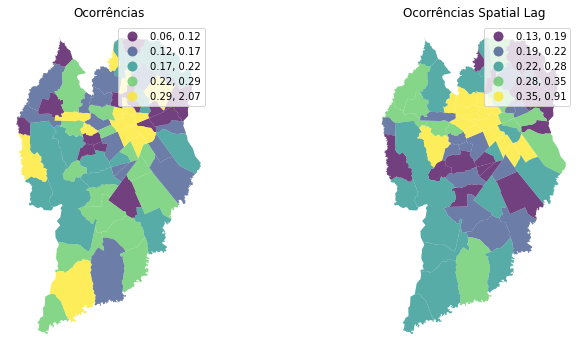

In [10]:
f, axs = plt.subplots(1, 2, figsize=(12, 6))
ax1, ax2 = axs

db.plot(
    column="OCORRENCIAS_ATENDIDAS_PER_CAPITA",
    cmap="viridis",
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=ax1,
)
ax1.set_axis_off()
ax1.set_title("Ocorrências")
# contextily.add_basemap(
#     ax1,
#     crs=db.crs,
#     source=contextily.providers.Stamen.TerrainBackground,
# )

db.plot(
    column="Occorencias_per_capita_lag",
    cmap="viridis",
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=ax2,
)
ax2.set_axis_off()
ax2.set_title("Ocorrências Spatial Lag")
# contextily.add_basemap(
#     ax2,
#     crs=db.crs,
#     source=contextily.providers.Stamen.TerrainBackground,
# )

plt.show()

In [11]:
db["Ocorrencias_std"] = db["OCORRENCIAS_ATENDIDAS_PER_CAPITA"] - db["OCORRENCIAS_ATENDIDAS_PER_CAPITA"].mean()
db["Ocorrencias_lag_std"] = db["Occorencias_per_capita_lag"] - db["Occorencias_per_capita_lag"].mean()

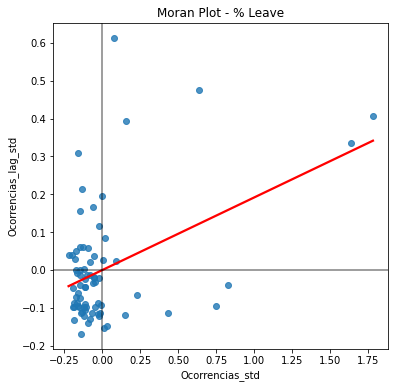

In [12]:
f, ax = plt.subplots(1, figsize=(6, 6))
seaborn.regplot(
    x="Ocorrencias_std",
    y="Ocorrencias_lag_std",
    ci=None,
    data=db,
    line_kws={"color": "r"},
)
ax.axvline(0, c="k", alpha=0.5)
ax.axhline(0, c="k", alpha=0.5)
ax.set_title("Moran Plot - % Leave")
plt.show()

In [13]:
moran = esda.moran.Moran(db["OCORRENCIAS_ATENDIDAS_PER_CAPITA"], w)
print('Moran\'s I: ', moran.I)
print('Moran\'s p: ', moran.p_sim)

Moran's I:  0.19163344441808067
Moran's p:  0.002


In [14]:
lisa = esda.moran.Moran_Local(db["OCORRENCIAS_ATENDIDAS_PER_CAPITA"], w)

In [15]:
spots_labels = {
    0: "Non-Significant",
    1: "HH",
    2: "LH",
    3: "LL",
    4: "HL",
}

db['labels'] = pd.Series(
    # First initialise a Series using values and `db` index
    ((1*(lisa.p_sim < 0.05)) * (lisa.q)),
    index=db.index
    # Then map each value to corresponding label based
    # on the `spots_labels` mapping
).map(spots_labels)

db.reset_index(inplace=True)
db.tail()

,NOME,OCORRENCIAS_ATENDIDAS_PER_CAPITA,geometry,Occorencias_per_capita_lag,Ocorrencias_std,Ocorrencias_lag_std,labels
69,SANTO INACIO,1.033957,"POLYGON ((-5490638.725 -2927646.697, -5490639....",0.201849,0.747565,-0.094735,Non-Significant
70,VISTA ALEGRE,0.139577,"POLYGON ((-5488456.296 -2924500.831, -5488501....",0.453673,-0.146815,0.157090,Non-Significant
71,SAO BRAZ,0.103984,"POLYGON ((-5493045.709 -2925482.796, -5493099....",0.326870,-0.182409,0.030287,Non-Significant
72,CASCATINHA,0.159146,"POLYGON ((-5488683.456 -2925644.261, -5488690....",0.358557,-0.127246,0.061973,Non-Significant
73,SANTA FELICIDADE,0.230513,"POLYGON ((-5490141.739 -2924318.296, -5490171....",0.277070,-0.055879,-0.019513,Non-Significant


In [16]:
db['labels'] = pd.Series(lisa.q,index=db.index).map(spots_labels)
db['labels_sig'] = pd.Series(1*(lisa.p_sim < 0.05)*lisa.q,index=db.index).map(spots_labels)

In [17]:
import json

f = open('../data/divisa_bairros_cleaned.geojson', encoding='utf-8')

bairros_geojson = json.load(f)

In [18]:
fig = px.choropleth_mapbox(db, geojson=bairros_geojson, color="labels",color_discrete_sequence=['red','green','blue','white','yellow'],
                           locations="NOME", featureidkey='properties.NOME',
                           center={"lat": -25.459717, "lon": -49.278820},
                           mapbox_style="carto-positron", zoom=9)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0}, width=600)
fig.show()

In [19]:
from splot import esda as esdaplot

(<Figure size 929.032x953.642 with 1 Axes>, <AxesSubplot:>)

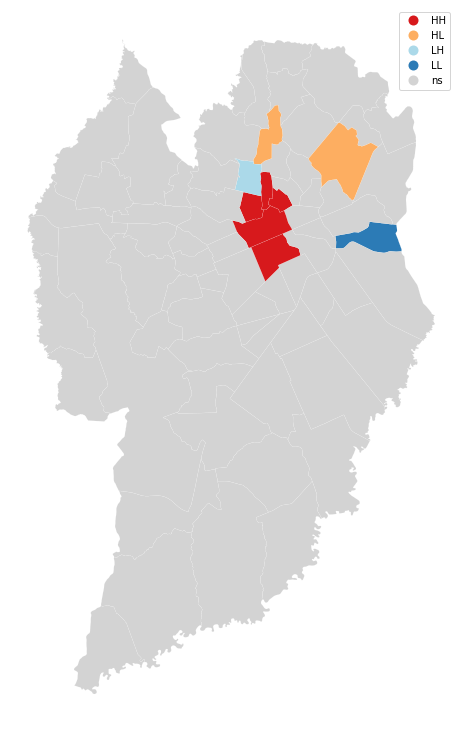

In [20]:
ax = plt.gca()

def set_size(w,h, ax=None):
    """ w, h: width, height in inches """
    if not ax: ax=plt.gca()
    l = ax.figure.subplotpars.left
    r = ax.figure.subplotpars.right
    t = ax.figure.subplotpars.top
    b = ax.figure.subplotpars.bottom
    figw = float(w)/(r-l)
    figh = float(h)/(t-b)
    ax.figure.set_size_inches(figw, figh)

set_size(10,10,ax)

esdaplot.lisa_cluster(lisa, db, p=.05, ax=ax)

In [35]:
lisa.q

## Espaço-temporal

In [3]:
import statsmodels.formula.api as smf

In [63]:
gmc_bairro_mes = df_gmc.groupby(by=['OCORRENCIA_ANO','OCORRENCIA_MES','ATENDIMENTO_BAIRRO_NOME']).size().reset_index(name='OCORRENCIAS')

In [64]:
def create_lag_feature(dataframe,feature_lag_name,lag=1):
    for idx, bairro in enumerate(dataframe['ATENDIMENTO_BAIRRO_NOME'].value_counts().index):
        bairro_slice = dataframe[dataframe['ATENDIMENTO_BAIRRO_NOME'] == bairro].sort_values(by=['OCORRENCIA_ANO','OCORRENCIA_MES'])
        shifted_values = bairro_slice['OCORRENCIAS'].shift(lag,fill_value=0)
        for idx in bairro_slice.index:
            dataframe.loc[idx,feature_lag_name] = shifted_values.loc[idx]

In [65]:
gmc_bairro_mes['OCORRENCIAS_LAG1'] = np.zeros(gmc_bairro_mes.shape[0])
gmc_bairro_mes['OCORRENCIAS_LAG2'] = np.zeros(gmc_bairro_mes.shape[0])
gmc_bairro_mes['OCORRENCIAS_LAG3'] = np.zeros(gmc_bairro_mes.shape[0])
gmc_bairro_mes['OCORRENCIAS_LAG4'] = np.zeros(gmc_bairro_mes.shape[0])
# gmc_bairro_mes['OCORRENCIAS_LAG5'] = np.zeros(gmc_bairro_mes.shape[0])
# gmc_bairro_mes['OCORRENCIAS_LAG6'] = np.zeros(gmc_bairro_mes.shape[0])
# gmc_bairro_mes['OCORRENCIAS_LAG7'] = np.zeros(gmc_bairro_mes.shape[0])
# gmc_bairro_mes['OCORRENCIAS_LAG8'] = np.zeros(gmc_bairro_mes.shape[0])


In [66]:

create_lag_feature(gmc_bairro_mes,'OCORRENCIAS_LAG1',1)
create_lag_feature(gmc_bairro_mes,'OCORRENCIAS_LAG2',2)
create_lag_feature(gmc_bairro_mes,'OCORRENCIAS_LAG3',3)
create_lag_feature(gmc_bairro_mes,'OCORRENCIAS_LAG4',4)
# create_lag_feature(gmc_bairro_mes,'OCORRENCIAS_LAG5',5)
# create_lag_feature(gmc_bairro_mes,'OCORRENCIAS_LAG6',6)
# create_lag_feature(gmc_bairro_mes,'OCORRENCIAS_LAG7',7)
# create_lag_feature(gmc_bairro_mes,'OCORRENCIAS_LAG8',8)

In [68]:
# gmc_bairro_mes.to_csv('ocorrencias_bairro_mes.csv',index=False)

In [35]:
print(gmc_bairro_mes[(gmc_bairro_mes['ATENDIMENTO_BAIRRO_NOME'] == 'XAXIM') & (gmc_bairro_mes['OCORRENCIA_ANO'] == 2009)])

In [99]:
gmc_bairro_mes['OCORRENCIAS_ULTIMO_MES'] = gmc_bairro_mes['OCORRENCIAS'].shift(fill_value=0)
gmc_bairro_mes['OCORRENCIAS_LAG2_MES'] = gmc_bairro_mes['OCORRENCIAS'].shift(periods=2,fill_value=0)
gmc_bairro_mes['OCORRENCIAS_MEDIA_ULTIMOS_MESES'] = gmc_bairro_mes['OCORRENCIAS'].shift(1).rolling(window=2).mean().fillna(0)
gmc_bairro_mes['STD_ULTIMO_MES'] = gmc_bairro_mes['OCORRENCIAS_ULTIMO_MES'] - gmc_bairro_mes['OCORRENCIAS_MEDIA_ULTIMOS_MESES']

## Model 1 

In [64]:
f1 = 'OCORRENCIAS ~ OCORRENCIA_ANO + OCORRENCIA_MES + ATENDIMENTO_BAIRRO_NOME - 1'

In [65]:
stm1 = smf.ols(f1, data=gmc_bairro_mes).fit()

In [66]:
stm1.summary()

In [67]:
pd.DataFrame(np.concatenate((gmc_bairro_mes.values, stm1.predict().reshape((-1,1))), axis=1))

## Model 2

In [8]:
f2 = ('OCORRENCIAS ~ ' +
    'OCORRENCIA_ANO ' +
    '+ OCORRENCIA_MES ' +
    '+ ATENDIMENTO_BAIRRO_NOME ' +
    '+ OCORRENCIAS_LAG1' +
    '+ OCORRENCIAS_LAG2' +
    '+ OCORRENCIAS_LAG3' +
    '+ OCORRENCIAS_LAG4' +
    # '+ OCORRENCIAS_LAG5' +
    # '+ OCORRENCIAS_LAG6' +
    # '+ OCORRENCIAS_LAG7' +
    # '+ OCORRENCIAS_LAG8' +
    '- 1')

In [10]:
stm2 = smf.ols(f2, data=gmc_bairro_mes).fit()
stm2.summary()

In [75]:
outliers_df = pd.DataFrame(np.concatenate((gmc_bairro_mes.drop(columns=['OCORRENCIAS_LAG1','OCORRENCIAS_LAG2','OCORRENCIAS_LAG3','OCORRENCIAS_LAG4']).values, stm2.predict().reshape((-1,1))), axis=1),
								columns=['OCORRENCIA_ANO','OCORRENCIA_MES','ATENDIMENTO_BAIRRO_NOME','OCORRENCIAS_ATENDIDAS','OCORRENCIAS_PREVISTAS'])

outliers_df['ERRO'] = outliers_df['OCORRENCIAS_PREVISTAS'] - outliers_df['OCORRENCIAS_ATENDIDAS']
outliers_df['Z-SCORE'] = (outliers_df['ERRO'] - outliers_df['ERRO'].mean())/outliers_df['ERRO'].std()
outliers_df['OUTLIER'] = outliers_df['Z-SCORE'].apply(lambda x: 1*(abs(x) >= 2.575))

In [91]:
outliers_df[outliers_df['OUTLIER'] == 1][['OCORRENCIA_ANO','OCORRENCIA_MES']].value_counts().reset_index().drop(columns=0).sort_values(by=['OCORRENCIA_ANO','OCORRENCIA_MES'])

In [89]:
marks = []
for idx, row in outliers_df[outliers_df['OUTLIER'] == 1].iterrows():
    if((row['OCORRENCIA_ANO'],row['OCORRENCIA_MES']) not in marks):
        marks.append((row['OCORRENCIA_ANO'],row['OCORRENCIA_MES']))
    
marks.sort()

marks = [{"value": idx, "label": f'{x[1]}/{x[0]}'} for idx, x in enumerate(marks)]

print(marks)

## Model 3

In [4]:
df_gmc['OCORRENCIA_DATA'] = pd.to_datetime(df_gmc['OCORRENCIA_DATA'], format='%Y-%m-%d %H:%M:%S.%f')
df_gmc['PANDEMIA'] = df_gmc['OCORRENCIA_DATA_SEM_HORARIO'].apply(lambda x: 1 if x >= datetime.strptime('11/04/2020','%d/%m/%Y').date() else 0)

In [5]:
df_gmc['OCORRENCIA_SEMANA'] = df_gmc['OCORRENCIA_DATA'].dt.week

In [6]:
gmc_bairro_semana = df_gmc.groupby(by=['ATENDIMENTO_BAIRRO_NOME','OCORRENCIA_ANO','OCORRENCIA_MES','OCORRENCIA_SEMANA','PANDEMIA']).size().reset_index(name='OCORRENCIAS')

In [8]:
gmc_bairro_semana.sort_values(by=['ATENDIMENTO_BAIRRO_NOME','OCORRENCIA_ANO','OCORRENCIA_MES','OCORRENCIA_SEMANA'],inplace=True)

In [9]:
def create_lag_feature(feature_lag_name, lag=1):
    for idx, bairro in enumerate(gmc_bairro_semana['ATENDIMENTO_BAIRRO_NOME'].value_counts().index):
        bairro_slice = gmc_bairro_semana[gmc_bairro_semana['ATENDIMENTO_BAIRRO_NOME'] == bairro]
        shifted_values = bairro_slice['OCORRENCIAS'].shift(lag,fill_value=0)
        for idx in bairro_slice.index:
            gmc_bairro_semana.loc[idx,feature_lag_name] = shifted_values.loc[idx]

In [7]:
gmc_bairro_semana['OCORRENCIAS_ULTIMA_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['OCORRENCIAS_LAG2_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['OCORRENCIAS_LAG3_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['OCORRENCIAS_LAG4_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['OCORRENCIAS_LAG5_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['OCORRENCIAS_LAG6_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['OCORRENCIAS_LAG7_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['OCORRENCIAS_LAG8_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['OCORRENCIAS_MEDIA_ULTIMAS_SEMANAS'] = np.zeros(gmc_bairro_semana.shape[0])

In [10]:
create_lag_feature('OCORRENCIAS_ULTIMA_SEMANA', 1)
create_lag_feature('OCORRENCIAS_LAG2_SEMANA', 2)
create_lag_feature('OCORRENCIAS_LAG3_SEMANA', 3)
create_lag_feature('OCORRENCIAS_LAG4_SEMANA', 4)
create_lag_feature('OCORRENCIAS_LAG5_SEMANA', 5)
create_lag_feature('OCORRENCIAS_LAG6_SEMANA', 6)
create_lag_feature('OCORRENCIAS_LAG7_SEMANA', 7)
create_lag_feature('OCORRENCIAS_LAG8_SEMANA', 8)

In [ ]:
gmc_bairro_semana['']

In [11]:
hotspots = ['CENTRO','CIDADE INDUSTRIAL DE CURITIBA','BOQUEIRAO','SITIO CERCADO']

In [12]:
gmc_bairro_semana['HOTSPOT'] = gmc_bairro_semana['ATENDIMENTO_BAIRRO_NOME'].apply(lambda bairro: 1*(bairro in hotspots))

In [60]:
def create_error_feature(error_feature_name, lag_feature_name):
    for idx, bairro in enumerate(gmc_bairro_semana['ATENDIMENTO_BAIRRO_NOME'].value_counts().index):
        bairro_slice = gmc_bairro_semana[gmc_bairro_semana['ATENDIMENTO_BAIRRO_NOME'] == bairro]
        bairro_mean = bairro_slice['OCORRENCIAS'].mean()
        for idx in bairro_slice.index:
            gmc_bairro_semana.loc[idx, error_feature_name] = (gmc_bairro_semana.loc[idx,lag_feature_name] - bairro_mean)**2

In [61]:
gmc_bairro_semana['ERRO_ULTIMA_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['ERRO_LAG2_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['ERRO_LAG3_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['ERRO_LAG4_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['ERRO_LAG5_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['ERRO_LAG6_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['ERRO_LAG7_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['ERRO_LAG8_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])

In [63]:
create_error_feature('ERRO_ULTIMA_SEMANA', 'OCORRENCIAS_ULTIMA_SEMANA')
create_error_feature('ERRO_LAG2_SEMANA', 'OCORRENCIAS_LAG2_SEMANA')
create_error_feature('ERRO_LAG3_SEMANA', 'OCORRENCIAS_LAG3_SEMANA')
create_error_feature('ERRO_LAG4_SEMANA', 'OCORRENCIAS_LAG4_SEMANA')
create_error_feature('ERRO_LAG5_SEMANA', 'OCORRENCIAS_LAG5_SEMANA')
create_error_feature('ERRO_LAG6_SEMANA', 'OCORRENCIAS_LAG6_SEMANA')
create_error_feature('ERRO_LAG7_SEMANA', 'OCORRENCIAS_LAG7_SEMANA')
create_error_feature('ERRO_LAG8_SEMANA', 'OCORRENCIAS_LAG8_SEMANA')

In [64]:
gmc_bairro_semana[gmc_bairro_semana['ATENDIMENTO_BAIRRO_NOME'] == 'XAXIM']

In [27]:
gmc_bairro_semana['ERRO_ULTIMA_SEMANA'] = gmc_bairro_semana['OCORRENCIAS_ULTIMA_SEMANA'] - gmc_bairro_semana['OCORRENCIAS_MEDIA_ULTIMAS_SEMANAS']
gmc_bairro_semana['ERRO_QUADRADO_ULTIMA_SEMANA'] = gmc_bairro_semana['ERRO_ULTIMA_SEMANA'].apply(lambda x: x**2)

In [69]:
f3 = ('OCORRENCIAS ~ OCORRENCIA_ANO ' +
    '+ OCORRENCIA_MES ' +
    '+ OCORRENCIA_SEMANA ' +
    # '+ ATENDIMENTO_BAIRRO_NOME ' +
    '+ OCORRENCIAS_ULTIMA_SEMANA ' +
    '+ OCORRENCIAS_LAG2_SEMANA' +
    '+ OCORRENCIAS_LAG3_SEMANA' +
    '+ OCORRENCIAS_LAG4_SEMANA' +
    '+ OCORRENCIAS_LAG5_SEMANA' +
    '+ OCORRENCIAS_LAG6_SEMANA' +
    '+ OCORRENCIAS_LAG7_SEMANA' +
    # '+ OCORRENCIAS_LAG8_SEMANA' +
    # '+ ERRO_ULTIMA_SEMANA ' +
    # '+ ERRO_LAG2_SEMANA ' +
    # '+ ERRO_LAG3_SEMANA ' +
    # '+ ERRO_LAG4_SEMANA ' +
    # '+ ERRO_LAG5_SEMANA ' +
    # '+ ERRO_LAG6_SEMANA ' +
    # '+ ERRO_LAG7_SEMANA ' +
    # '+ ERRO_LAG8_SEMANA ' +
    '+ HOTSPOT ' +
    '+ PANDEMIA ' +
    '- 1')

In [70]:
stm3 = smf.ols(f3, data=gmc_bairro_semana).fit()
stm3.summary()

## Space Model 1

In [85]:
from sklearn.neighbors import LocalOutlierFactor


In [93]:
bairro_hot_encoding = pd.get_dummies(gmc_bairro_semana['ATENDIMENTO_BAIRRO_NOME'], prefix='BAIRRO')

In [102]:
lof_bairro_semana = pd.concat([gmc_bairro_semana.drop(columns=['ATENDIMENTO_BAIRRO_NOME']),bairro_hot_encoding],axis=1)
lof_bairro_semana.tail()

In [103]:
X = lof_bairro_semana.values

In [105]:
clf = LocalOutlierFactor()
clf.fit_predict(X)

clf.negative_outlier_factor_

In [106]:
lof_score = clf.negative_outlier_factor_.reshape(-1,1)

In [113]:
fixe = pd.concat([gmc_bairro_semana,pd.DataFrame(lof_score,columns=['LOF_SCORE'])],axis=1)

In [115]:
px.histogram(fixe['LOF_SCORE'])

In [121]:
fixe[fixe['LOF_SCORE'] < -1.5]['ATENDIMENTO_BAIRRO_NOME'].value_counts()